<a href="https://colab.research.google.com/github/INmais/reliable/blob/master/Reliable_0221.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Reliable project

####Copernicus
* July equalled, and maybe surpassed, the hottest month in recorded history

https://public.wmo.int/en/media/news/july-equalled-and-maybe-surpassed-hottest-month-recorded-history

#### Notes
* Install in a separare virtual enviroment (namely shapely, geocondas and fiona from pip, not conda), otherwise will may get error due to different versions ('Shell is not a LinearRing'error) when reading shapefiles with geopandas

* Need to install libspatialindex and rtree. otherwise error "Could not find libspatialindex_c library file"


#### Data
*Datasets are also here: https://github.com/INmais/reliable/tree/master/data_notebooks

In [ ]:
! pip install geopandas
! pip install scikit-learn
! pip install requests

     |████████████████████████████████| 972kB 9.2MB/s 
     |████████████████████████████████| 14.8MB 239kB/s 
     |████████████████████████████████| 6.5MB 58.3MB/s 


In [ ]:
import requests

data = {
  'user': 'reliable',
  'pass': '9ykhCFG1PB1dwvm5',
  'coord': '-9.24,41.51',
  'vars': 't2'
}

headers = {
    'Content-Type': 'application/json',
}


response = requests.post('http://caboruivo.tecnico.ulisboa.pt:64104/api/', data=data, headers=headers)

In [ ]:
response = requests.get(' http://caboruivo.tecnico.ulisboa.pt:64104/api/forecast', data=data)

In [ ]:
import requests

data = {
  'coord': '-9.24,41.51',
  'vars': 't2'
}

response = requests.post(' http://caboruivo.tecnico.ulisboa.pt:64104/api/forecast', data=data, auth=('reliable', '9ykhCFG1PB1dwvm5'))

In [ ]:
pastebin_url = response.json()

In [ ]:
pastebin_url

{'atts': {'description': '2m air temperature', 'units': '°C'},
 'created': '2021-02-15T11:55:25+0000',
 'data': [13.3,
  13.3,
  13.4,
  13.4,
  13.4,
  13.4,
  13.4,
  13.4,
  13.4,
  13.3,
  13.2,
  13.3,
  13.2,
  13.1,
  13.2,
  13.2,
  13.2,
  13.1,
  13.1,
  13.3,
  13.3,
  13.4,
  13.4,
  13.6,
  13.8,
  13.8,
  13.9,
  14.2,
  14.4,
  14.6,
  14.8,
  14.9,
  15.1,
  14.9,
  14.7,
  14.5,
  14.6,
  14.3,
  14.2,
  14.2,
  14.1,
  14.0,
  14.1,
  14.1,
  14.2,
  14.2,
  14.0,
  14.2,
  14.4,
  14.7,
  14.9,
  15.0,
  15.2,
  14.8,
  14.5,
  14.5,
  14.6,
  14.2,
  13.9,
  13.8,
  13.8,
  13.7,
  13.4,
  13.2,
  13.1,
  12.2,
  12.6,
  12.8,
  12.5,
  12.7,
  12.8,
  12.9,
  13.0,
  12.9,
  13.0,
  13.2,
  13.2,
  13.2,
  13.1,
  13.1,
  13.1,
  13.2,
  13.1,
  13.1,
  13.0,
  13.0,
  12.9,
  12.8,
  12.9,
  12.9,
  12.9,
  12.9,
  12.9,
  12.8,
  13.0,
  12.8,
  12.9,
  13.0,
  13.0,
  13.1,
  13.1,
  13.1,
  13.1,
  13.2,
  13.2,
  13.1,
  13.3,
  13.2,
  13.1,
  13.1,
  13.1,
 

exemplo o comando curl:

Ex: curl -u <USERNAME>:<PASSWORD> -d "coord=-9.24,41.51&vars=t2" http://meteo2-ciist.ist.utl.pt:8080/api/forecast

Mais informações sobre a API em http://meteo2-ciist.ist.utl.pt:8080/api

O webservice está agora temporariamente em http://caboruivo.tecnico.ulisboa.pt:64104.


#### Libraries

In [ ]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd

import matplotlib
import descartes

#for interative plot
import plotly
import json
import plotly.graph_objs as go

In [ ]:
url_censos="https://raw.githubusercontent.com/INmais/reliable/master/data_notebooks/BGRI2011_1706/BGRI2011_1706.csv"
censos = pd.read_csv(url_censos, header=0, sep=";", encoding = "ISO-8859-1") 
censos.head()

,ANO,GEO_COD,GEO_COD_DSG,NIVEL,NIVEL_DSG,N_EDIFICIOS_CLASSICOS,N_EDIFICIOS_CLASSICOS_1OU2,N_EDIFICIOS_CLASSICOS_ISOLADOS,N_EDIFICIOS_CLASSICOS_GEMIN,N_EDIFICIOS_CLASSICOS_EMBANDA,N_EDIFICIOS_CLASSICOS_3OUMAIS,N_EDIFICIOS_CLASSICOS_OUTROS,N_EDIFICIOS_EXCLUSIV_RESID,N_EDIFICIOS_PRINCIPAL_RESID,N_EDIFICIOS_PRINCIP_NAO_RESID,N_EDIFICIOS_1OU2_PISOS,N_EDIFICIOS_3OU4_PISOS,.N_EDIFICIOS_5OU_MAIS_PISOS,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_1946A1960,N_EDIFICIOS_CONSTR_1961A1970,N_EDIFICIOS_CONSTR_1971A1980,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_1991A1995,N_EDIFICIOS_CONSTR_1996A2000,N_EDIFICIOS_CONSTR_2001A2005,N_EDIFICIOS_CONSTR_2006A2011,N_EDIFICIOS_ESTRUT_BETAO,N_EDIFICIOS_ESTRUT_COM_PLACA,N_EDIFICIOS_ESTRUT_SEM_PLACA,N_EDIFICIOS_ESTRUT_ADOBE_PEDRA,N_EDIFICIOS_ESTRUT_OUTRA,N_ALOJAMENTOS,N_ALOJAMENTOS_FAMILIARES,N_ALOJAMENTOS_FAM_CLASSICOS,N_ALOJAMENTOS_FAM_N_CLASSICOS,N_ALOJAMENTOS_COLECTIVOS,N_CLASSICOS_RES_HABITUAL,N_ALOJAMENTOS_RES_HABITUAL,...,N_INDIVIDUOS_RESIDENT_H_10A13,N_INDIVIDUOS_RESIDENT_H_14A19,N_INDIVIDUOS_RESIDENT_H_15A19,N_INDIVIDUOS_RESIDENT_H_20A24,N_INDIVIDUOS_RESIDENT_H_20A64,N_INDIVIDUOS_RESIDENT_H_25A64,N_INDIVIDUOS_RESIDENT_H_65,N_INDIVIDUOS_RESIDENT_M_0A4,N_INDIVIDUOS_RESIDENT_M_5A9,N_INDIVIDUOS_RESIDENT_M_10A13,N_INDIVIDUOS_RESIDENT_M_14A19,N_INDIVIDUOS_RESIDENT_M_15A19,N_INDIVIDUOS_RESIDENT_M_20A24,N_INDIVIDUOS_RESIDENT_M_20A64,N_INDIVIDUOS_RESIDENT_M_25A64,N_INDIVIDUOS_RESIDENT_M_65,N_INDIV_RESIDENT_N_LER_ESCRV,N_IND_RESIDENT_FENSINO_1BAS,N_IND_RESIDENT_FENSINO_2BAS,N_IND_RESIDENT_FENSINO_3BAS,N_IND_RESIDENT_FENSINO_SEC,N_IND_RESIDENT_FENSINO_POSSEC,N_IND_RESIDENT_FENSINO_SUP,N_IND_RESIDENT_ENSINCOMP_1BAS,N_IND_RESIDENT_ENSINCOMP_2BAS,N_IND_RESIDENT_ENSINCOMP_3BAS,N_IND_RESIDENT_ENSINCOMP_SEC,N_IND_RESIDENT_ENSINCOMP_POSEC,N_IND_RESIDENT_ENSINCOMP_SUP,N_IND_RESID_DESEMP_PROC_1EMPRG,N_IND_RESID_DESEMP_PROC_EMPRG,N_IND_RESID_EMPREGADOS,N_IND_RESID_PENS_REFORM,N_IND_RESID_SEM_ACT_ECON,N_IND_RESID_EMPREG_SECT_PRIM,N_IND_RESID_EMPREG_SECT_SEQ,N_IND_RESID_EMPREG_SECT_TERC,N_IND_RESID_ESTUD_MUN_RESID,N_IND_RESID_TRAB_MUN_RESID,Unnamed: 127
0,2011,'PT,PT,1,Total Nacional,3544389,3219791,1946604,542393,730794,283879,40719,3305062,213090,26237,3007616,432760,104013,206343,305696,387340,408831,588858,578845,268179,290292,300635,209370,1721109,1123774,481115,189072,29319,5878756,5866152,5859540,6612,12604,3991112,3997724,...,231797,345366,288525,293023,3111752,2818729,842324,236251,256122,221931,330751,276725,289042,3302783,3013741,1167740,499936,477565,269275,423199,423925,20437,379708,2688308,1412580,1716970,1411801,88023,1244742,122310,539870,4361187,2339094,3966482,133386,1154709,3073092,1773245,2860521,NaN
1,2011,'1,Continente,2,NUT1,3353610,3035969,1820486,516785,698698,278222,39419,3121458,207292,24860,2837161,414564,101885,195169,288132,365612,390633,565368,546632,253730,272578,280855,194901,1599434,1098244,449413,178421,28098,5639257,5627555,5621098,6457,11702,3818574,3825031,...,218552,324869,271397,275607,2953606,2677999,814954,223445,241712,209168,311214,260260,272229,3140450,2868221,1122834,472919,447944,252148,398953,402148,19148,365049,2552130,1329508,1638624,1355254,83485,1198453,114999,515712,4150252,2257145,3782538,121055,1115357,2913840,1669455,2697144,NaN
2,2011,'11,Norte,3,NUT2,1209911,1118014,744666,200722,172626,80452,11445,1116665,85088,8158,1025944,156160,27807,71817,87996,112397,133424,206637,216376,100530,104083,103963,72688,597409,399887,162483,40729,9403,1850890,1847784,1846589,1195,3106,1319665,1320860,...,85491,129570,108207,107325,1109290,1001965,263910,79976,90876,81176,124222,103870,106474,1179643,1073169,367529,167451,168747,98335,158704,152953,6650,128913,1018389,563972,578950,437916,26221,375392,46644,207538,1501883,768566,1376384,43023,533848,925012,631487,1008020,NaN
3,2011,'118,Alto Trás-os-Montes,4,NUT3,127220,123194,66466,26515,30213,3378,648,116407,10038,775,111979,13985,1256,7246,8900,11286,14503,25198,24046,10359,9218,9464,700

#### IV Index

In [ ]:
url_iv = 'https://raw.githubusercontent.com/INmais/reliable/master/data_notebooks/IndiceVulnerabilidadeMontalegre.csv'
iv = pd.read_csv(url_iv, header=0, sep=";", encoding = "ISO-8859-1") 
#had to change encoding
iv["IV"] = pd.to_numeric(iv["IV"])
iv.head()

,Freguesia,IV
0,170601,10
1,170602,10
2,170603,11
3,170604,11
4,170605,10


#### Source "IV Index":
Susana Silva, Rita Roquette1, Baltazar Nunes, Mapeamento de índice de vulnerabilidade a ondas de calor, International Conference on Urban Risks (ICUR 2016) 

http://repositorio.insa.pt/bitstream/10400.18/3870/1/ICUR2016_Poster_final.pdf 

##### Other References:
Mapping community determinants of heat vulnerability." (https://www.ncbi.nlm.nih.gov/pubmed/20049125)

Development of a heat vulnerability index for New York State. (https://www.ncbi.nlm.nih.gov/pubmed/29195682)

## Shapefile

Source: INE Censos 2011 http://mapas.ine.pt/download/index2011.phtml
Source: INE Censos 2011 http://mapas.ine.pt/download/index2011.phtml

In [ ]:
os.getcwd()  # current working directory

'/content'

In [ ]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [ ]:
# files in "/content/drive/My Drive/Law & Tech".
!ls "/content/drive/My Drive/Buildings and Health"

 176670.pdf
'Análise de Séries Temporais em Saúde Pública_2019.pdf'
 BGRI2011_1706
 Buildings
'Call FCT - Data Science (Heathcare).gdoc'
 camp.csv
'Certificado INSA ST.pdf'
 certificados_info.xlsx
'Datasets transparecia saude.gsheet'
 Datasheet_EOT_Amb_EN.pdf
 df.cpg
 df.csv
 df.dbf
 df.shp
 df.shx
 Energy_Plus
 EP.ipynb
'Factura INSA ST.pdf'
'INSA - Series Temporais.pdf'
 Julho1991.csv
'Line up.gdoc'
'Listagens SCE - IST Reliable.7z'
 Literatura.gdoc
 manual_completo_Amb_EN.pdf
 map_df0707.csv
 map_df0708.csv
 map_df0717.csv
 map_df2
 map_df22.csv
 map_df23.csv
 map_df2.csv
 map_df2geo
 map_df3.csv
 map_df.csv
 map_dfdata.csv
 map_df.geojson
 mapeamento-entre-codigos-de-centros-de-custo-usados-no-rhv-e-codigos-da-hierarqu.xls
 mapgeojson.geojson
 maps.geojson
 Mort_IHD2.csv
 Mort_IHD.csv
 MPRA_paper_52456.pdf
 NDVI.tif
 Notes.gsheet
'Passaporte INSA ST.pdf'
'Pedido de autorização para a recolha e uso de dados.gdoc'
 Portugal_GC_CR.csv
 Projeçoes.R
 Rcode_curso_ITSA.R
 Reliable_

In [ ]:
os.chdir('/content/drive/My Drive/Buildings and Health') # Provide the new path here

In [ ]:
os.getcwd()

'/content/drive/My Drive/Buildings and Health'

In [ ]:
#Geopandas Shell is not a LinearRing bug (needs clean enviroment, otherwise problem with shapefiles version)
fp = "/content/drive/My Drive/Buildings and Health/BGRI2011_1706/BGRI2011_1706.shp" #INE Census 2011 Data
map_df = gpd.read_file(fp) 

In [ ]:
print (map_df.columns)

Index(['DTMN11', 'FR11', 'SEC11', 'SS11', 'BGRI11', 'LUG11', 'LUG11DESIG',
       'geometry'],
      dtype='object')


In [ ]:
map_df.crs

<Projected CRS: EPSG:3763>
Name: ETRS89 / Portugal TM06
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: Portugal - mainland - onshore.
- bounds: (-9.56, 36.95, -6.19, 42.16)
Coordinate Operation:
- name: Portugual TM06
- method: Transverse Mercator
Datum: European Terrestrial Reference System 1989
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
map_df['Freguesias'] = map_df["DTMN11"] + map_df["FR11"]

In [ ]:
Dictionary = {
    '170601': 10,
    '170602': 10,
    '170603': 11,
    '170604': 11,
    '170605': 10,
    '170606': 10,
    '170607': 11,
    '170608': 9,
    '170609': 11,
    '170610': 9,
    '170611': 14,
    '170612': 10,
    '170613': 11,
    '170614': 12,
    '170615': 9,
    '170616': 10,
    '170617': 9,
    '170618': 10,
    '170619': 10,
    '170620': 11,
    '170621': 9,
    '170622': 11,
    '170623': 10,
    '170624': 11,
    '170625': 14,
    '170626': 10,
    '170627': 10,
    '170628': 12,
    '170629': 9,
    '170630': 11,
    '170631': 11,
    '170632':10,
    '170633': 12,
    '170634': 9,
    '170635': 11
}
print (Dictionary)

{'170601': 10, '170602': 10, '170603': 11, '170604': 11, '170605': 10, '170606': 10, '170607': 11, '170608': 9, '170609': 11, '170610': 9, '170611': 14, '170612': 10, '170613': 11, '170614': 12, '170615': 9, '170616': 10, '170617': 9, '170618': 10, '170619': 10, '170620': 11, '170621': 9, '170622': 11, '170623': 10, '170624': 11, '170625': 14, '170626': 10, '170627': 10, '170628': 12, '170629': 9, '170630': 11, '170631': 11, '170632': 10, '170633': 12, '170634': 9, '170635': 11}


In [ ]:
# converting to dict 
dictv = iv.set_index('Freguesia').to_dict('IV')

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:1490: FutureWarning:

Using short name for 'orient' is deprecated. Only the options: ('dict', list, 'series', 'split', 'records', 'index') will be used in a future version. Use one of the above to silence this warning.



In [ ]:
map_df["IV"] = map_df['Freguesias'].map(Dictionary)

In [ ]:
map_df["IV"]

0        9
1       14
2       10
3       10
4        9
        ..
1412     9
1413    12
1414    12
1415    12
1416     9
Name: IV, Length: 1417, dtype: int64

In [ ]:
map_df['Freguesias'] #check

0       170634
1       170625
2       170626
3       170612
4       170608
         ...  
1412    170615
1413    170628
1414    170628
1415    170628
1416    170617
Name: Freguesias, Length: 1417, dtype: object

In [ ]:
print (map_df['geometry'])

0       POLYGON ((26131.419 232084.486, 26132.562 2320...
1       POLYGON ((17805.883 228000.617, 17808.574 2279...
2       POLYGON ((16606.640 223659.710, 16624.320 2236...
3       POLYGON ((35531.563 242104.051, 35531.899 2420...
4       POLYGON ((26191.654 240495.840, 26197.767 2404...
                              ...                        
1412    POLYGON ((29757.809 242119.073, 29753.558 2421...
1413    POLYGON ((41355.964 243031.728, 41355.693 2429...
1414    POLYGON ((41395.348 243080.786, 41395.602 2430...
1415    POLYGON ((41805.822 243116.282, 41813.470 2430...
1416    POLYGON ((25332.823 245771.096, 25330.083 2457...
Name: geometry, Length: 1417, dtype: geometry


### Mapping Index

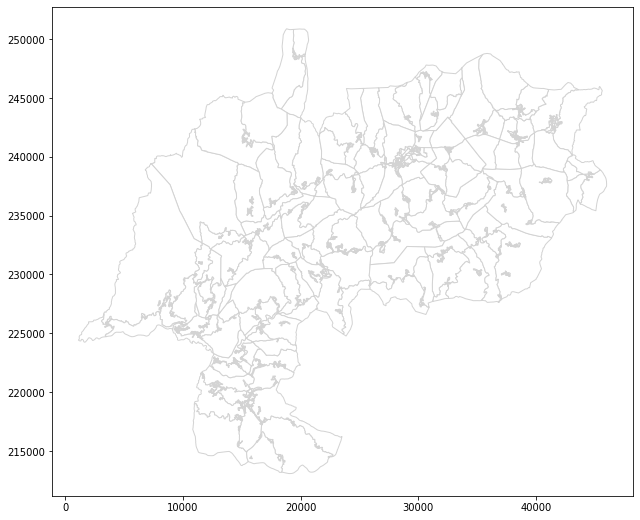

In [ ]:
map_df.plot(color='white', edgecolor='lightgrey', figsize=(11,9))

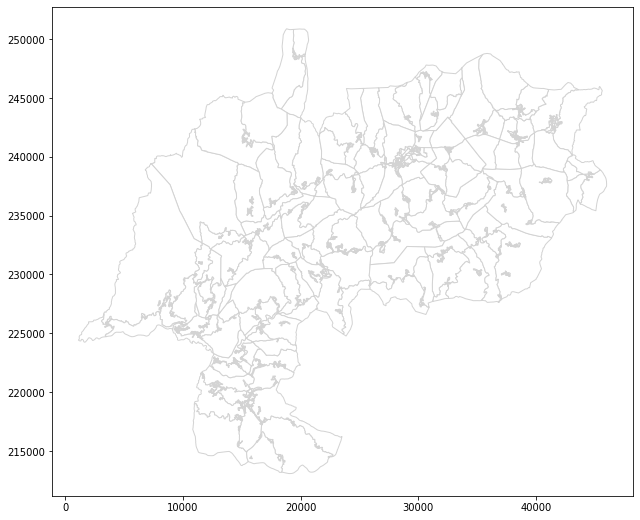

In [ ]:
ax0 = map_df.plot(color='white', edgecolor='lightgrey', figsize=(11,9))

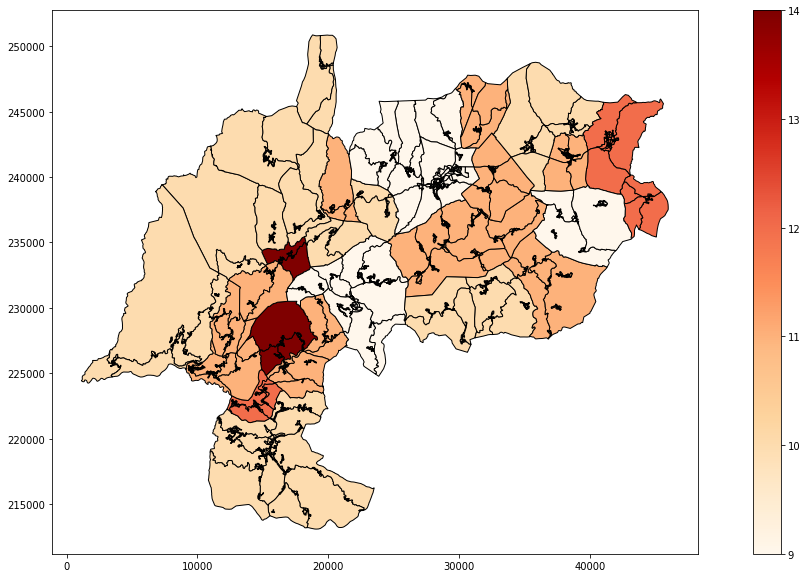

In [ ]:
ax= map_df.plot(column='IV', figsize=(20,10), cmap='OrRd', legend=True, edgecolor='black')

In [ ]:
from urllib.request import urlopen
map_df.to_file("maps.geojson", driver='GeoJSON')

In [ ]:
map_df = map_df.to_crs({'init': 'epsg:4326'})

/usr/local/lib/python3.6/dist-packages/pyproj/crs/crs.py:53: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



In [ ]:
maps = map_df.to_file("map_df.geojson", driver="GeoJSON")

In [ ]:
maps

In [ ]:
map_df['Freguesias'] = map_df.index
map_df

,DTMN11,FR11,SEC11,SS11,BGRI11,LUG11,LUG11DESIG,geometry,Freguesias,IV
0,1706,34,002,38,17063400238,999999,Residual,"POLYGON ((-7.81889 41.75777, -7.81888 41.75774...",0,9
1,1706,25,001,15,17062500115,014045,Ladrugães,"POLYGON ((-7.91912 41.72123, -7.91909 41.72118...",1,14
2,1706,26,001,42,17062600142,999999,Residual,"POLYGON ((-7.93366 41.68217, -7.93345 41.68212...",2,10
3,1706,12,001,31,17061200131,999999,Residual,"POLYGON ((-7.70527 41.84761, -7.70527 41.84712...",3,10
4,1706,08,001,08,17060800108,013976,Donões,"POLYGON ((-7.81780 41.83350, -7.81773 41.83344...",4,9
...,...,...,...,...,...,...,...,...,...,...
1412,1706,15,001,44,17061500144,999999,Residual,"POLYGON ((-7.77479 41.84798, -7.77484 41.84792...",1412,9
1413,1706,28,002,03,17062800203,014068,Vilar de Perdizes,"POLYGON ((-7.63507 41.85568, -7.63508 41.85529...",1413,12
1414,1706,28,002,02,17062800202,014068,Vilar de Perdizes,"POLYGON ((-7.63459 41.85612, -7.63459 41.85610...",1414,12
1415,1706,28,001,11,17062800111,014068,Vilar de Perdizes,"POLYGON ((-7.62965 41.85642, -7.62956 41.85627...",1415,12


In [ ]:
from urllib.request import urlopen
import json
import plotly.express as px


fig = px.choropleth_mapbox(map_df, geojson=map_df, locations='Freguesias', color='IV',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 41.785061, "lon": -7.781880},
                           opacity=0.5)
fig.show()

In [ ]:
censos.set_index('GEO_COD').join(map_df.set_index('Freguesias'))
#map_df.join(df.set_index('GEO_COD'), on='Freguesias')

,ANO,GEO_COD_DSG,NIVEL,NIVEL_DSG,N_EDIFICIOS_CLASSICOS,N_EDIFICIOS_CLASSICOS_1OU2,N_EDIFICIOS_CLASSICOS_ISOLADOS,N_EDIFICIOS_CLASSICOS_GEMIN,N_EDIFICIOS_CLASSICOS_EMBANDA,N_EDIFICIOS_CLASSICOS_3OUMAIS,N_EDIFICIOS_CLASSICOS_OUTROS,N_EDIFICIOS_EXCLUSIV_RESID,N_EDIFICIOS_PRINCIPAL_RESID,N_EDIFICIOS_PRINCIP_NAO_RESID,N_EDIFICIOS_1OU2_PISOS,N_EDIFICIOS_3OU4_PISOS,.N_EDIFICIOS_5OU_MAIS_PISOS,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_1946A1960,N_EDIFICIOS_CONSTR_1961A1970,N_EDIFICIOS_CONSTR_1971A1980,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_1991A1995,N_EDIFICIOS_CONSTR_1996A2000,N_EDIFICIOS_CONSTR_2001A2005,N_EDIFICIOS_CONSTR_2006A2011,N_EDIFICIOS_ESTRUT_BETAO,N_EDIFICIOS_ESTRUT_COM_PLACA,N_EDIFICIOS_ESTRUT_SEM_PLACA,N_EDIFICIOS_ESTRUT_ADOBE_PEDRA,N_EDIFICIOS_ESTRUT_OUTRA,N_ALOJAMENTOS,N_ALOJAMENTOS_FAMILIARES,N_ALOJAMENTOS_FAM_CLASSICOS,N_ALOJAMENTOS_FAM_N_CLASSICOS,N_ALOJAMENTOS_COLECTIVOS,N_CLASSICOS_RES_HABITUAL,N_ALOJAMENTOS_RES_HABITUAL,N_ALOJAMENTOS_VAGOS,...,N_INDIVIDUOS_RESIDENT_M_10A13,N_INDIVIDUOS_RESIDENT_M_14A19,N_INDIVIDUOS_RESIDENT_M_15A19,N_INDIVIDUOS_RESIDENT_M_20A24,N_INDIVIDUOS_RESIDENT_M_20A64,N_INDIVIDUOS_RESIDENT_M_25A64,N_INDIVIDUOS_RESIDENT_M_65,N_INDIV_RESIDENT_N_LER_ESCRV,N_IND_RESIDENT_FENSINO_1BAS,N_IND_RESIDENT_FENSINO_2BAS,N_IND_RESIDENT_FENSINO_3BAS,N_IND_RESIDENT_FENSINO_SEC,N_IND_RESIDENT_FENSINO_POSSEC,N_IND_RESIDENT_FENSINO_SUP,N_IND_RESIDENT_ENSINCOMP_1BAS,N_IND_RESIDENT_ENSINCOMP_2BAS,N_IND_RESIDENT_ENSINCOMP_3BAS,N_IND_RESIDENT_ENSINCOMP_SEC,N_IND_RESIDENT_ENSINCOMP_POSEC,N_IND_RESIDENT_ENSINCOMP_SUP,N_IND_RESID_DESEMP_PROC_1EMPRG,N_IND_RESID_DESEMP_PROC_EMPRG,N_IND_RESID_EMPREGADOS,N_IND_RESID_PENS_REFORM,N_IND_RESID_SEM_ACT_ECON,N_IND_RESID_EMPREG_SECT_PRIM,N_IND_RESID_EMPREG_SECT_SEQ,N_IND_RESID_EMPREG_SECT_TERC,N_IND_RESID_ESTUD_MUN_RESID,N_IND_RESID_TRAB_MUN_RESID,Unnamed: 127,DTMN11,FR11,SEC11,SS11,BGRI11,LUG11,LUG11DESIG,geometry,IV
GEO_COD,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
'PT,2011,PT,1,Total Nacional,3544389,3219791,1946604,542393,730794,283879,40719,3305062,213090,26237,3007616,432760,104013,206343,305696,387340,408831,588858,578845,268179,290292,300635,209370,1721109,1123774,481115,189072,29319,5878756,5866152,5859540,6612,12604,3991112,3997724,735128,...,221931,330751,276725,289042,3302783,3013741,1167740,499936,477565,269275,423199,423925,20437,379708,2688308,1412580,1716970,1411801,88023,1244742,122310,539870,4361187,2339094,3966482,133386,1154709,3073092,1773245,2860521,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN
'1,2011,Continente,2,NUT1,3353610,3035969,1820486,516785,698698,278222,39419,3121458,207292,24860,2837161,414564,101885,195169,288132,365612,390633,565368,546632,253730,272578,280855,194901,1599434,1098244,449413,178421,28098,5639257,5627555,5621098,6457,11702,3818574,3825031,704054,...,209168,311214,260260,272229,3140450,2868221,1122834,472919,447944,252148,398953,402148,19148,365049,2552130,1329508,1638624,1355254,83485,1198453,114999,515712,4150252,2257145,3782538,121055,1115357,2913840,1669455,2697144,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN
'11,2011,Norte,3,NUT2,1209911,1118014,744666,200722,172626,80452,11445,1116665,85088,8158,1025944,156160,27807,71817,87996,112397,133424,206637,216376,100530,104083,103963,72688,597409,399887,162483,40729,9403,1850890,1847784,1846589,1195,3106,1319665,1320860,202431,...,81176,124222,103870,106474,1179643,1073169,367529,167451,168747,98335,158704,152953,6650,128913,1018389,563972,578950,437916,26221,375392,46644,207538,1501883,768566,1376384,43023,533848,925012,631487,1008020,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN
'118,2011,Alto Trás-os-Montes,4,NUT3,127220,123194,66466,26515,30213,3378,648,116407,10038,775,111979,13985,1256,7246,8900,11286,14503,25198,24046,10359,9218,9464,7000,53609,46859,18953,6844,955,150758,150341,150273,68,417,80923,80991,13832,...,3348,5785,4894,5191,58051,52860,31982,19472,6973,4131,6955,7089,464,7110,64137,24552,26866,2

In [ ]:
censos.index

RangeIndex(start=0, stop=1500, step=1)

In [ ]:
censos['N_EDIFICIOS_CONSTR_ANTES_1919'].sum

<bound method Series.sum of 0       206343
1       195169
2        71817
3         7246
4         1051
         ...  
1495         0
1496         0
1497         0
1498         0
1499         0
Name: N_EDIFICIOS_CONSTR_ANTES_1919, Length: 1500, dtype: int64>

In [ ]:
censos['N_EDIFICIOS_CLASSICOS'].head()

0    3544389
1    3353610
2    1209911
3     127220
4      10157
Name: N_EDIFICIOS_CLASSICOS, dtype: int64

In [ ]:
censos['N_ALOJAMENTOS'].head()

0    5878756
1    5639257
2    1850890
3     150758
4      10555
Name: N_ALOJAMENTOS, dtype: int64

# Build Enviroment

url:  (https://www.ine.pt/bddXplorer/htdocs/minfo.jsp?var_cd=0005970)




In [ ]:
censord = censos[['ANO','GEO_COD','GEO_COD_DSG','NIVEL','NIVEL_DSG','N_EDIFICIOS_CONSTR_ANTES_1919','N_EDIFICIOS_CONSTR_1919A1945','N_EDIFICIOS_CONSTR_1946A1960','N_EDIFICIOS_CONSTR_1961A1970', 'N_EDIFICIOS_CONSTR_1971A1980','N_EDIFICIOS_CONSTR_1981A1990','N_EDIFICIOS_CONSTR_1991A1995', 'N_EDIFICIOS_CONSTR_1996A2000', 'N_EDIFICIOS_CONSTR_2001A2005','N_EDIFICIOS_CONSTR_2006A2011', 
'N_INDIVIDUOS_RESIDENT_0A4', 'N_INDIVIDUOS_RESIDENT_5A9','N_INDIVIDUOS_RESIDENT_10A13','N_INDIVIDUOS_RESIDENT_14A19','N_INDIVIDUOS_RESIDENT_15A19','N_INDIVIDUOS_RESIDENT_20A24','N_INDIVIDUOS_RESIDENT_20A64','N_INDIVIDUOS_RESIDENT_25A64','N_INDIVIDUOS_RESIDENT_65']]

In [ ]:
censord['all buildings'] = censord['N_EDIFICIOS_CONSTR_ANTES_1919'] + censord['N_EDIFICIOS_CONSTR_1919A1945'] + censord['N_EDIFICIOS_CONSTR_1946A1960'] + censord['N_EDIFICIOS_CONSTR_1961A1970'] + censord['N_EDIFICIOS_CONSTR_1971A1980']+ censord['N_EDIFICIOS_CONSTR_1981A1990'] + censord['N_EDIFICIOS_CONSTR_1991A1995'] + censord['N_EDIFICIOS_CONSTR_1996A2000'] + censord['N_EDIFICIOS_CONSTR_2001A2005'] + censord['N_EDIFICIOS_CONSTR_2006A2011']

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
censord['all pop'] = censord['N_INDIVIDUOS_RESIDENT_0A4'] + censord['N_INDIVIDUOS_RESIDENT_5A9'] + censord['N_INDIVIDUOS_RESIDENT_10A13'] + censord['N_INDIVIDUOS_RESIDENT_14A19'] + censord['N_INDIVIDUOS_RESIDENT_15A19'] + censord['N_INDIVIDUOS_RESIDENT_20A24'] + censord['N_INDIVIDUOS_RESIDENT_20A64'] + censord['N_INDIVIDUOS_RESIDENT_25A64'] + censord['N_INDIVIDUOS_RESIDENT_65']

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
censord['GEO_COD'] = censord['GEO_COD'].str.replace("\'", "")
#censord['GEO_COD'] =  pd.to_numeric(censord['GEO_COD'])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
censosbgri = censord[censord['NIVEL'] == 8]  

In [ ]:
len(censosbgri)

1417

In [ ]:
censosbgri

,ANO,GEO_COD,GEO_COD_DSG,NIVEL,NIVEL_DSG,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_1946A1960,N_EDIFICIOS_CONSTR_1961A1970,N_EDIFICIOS_CONSTR_1971A1980,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_1991A1995,N_EDIFICIOS_CONSTR_1996A2000,N_EDIFICIOS_CONSTR_2001A2005,N_EDIFICIOS_CONSTR_2006A2011,N_INDIVIDUOS_RESIDENT_0A4,N_INDIVIDUOS_RESIDENT_5A9,N_INDIVIDUOS_RESIDENT_10A13,N_INDIVIDUOS_RESIDENT_14A19,N_INDIVIDUOS_RESIDENT_15A19,N_INDIVIDUOS_RESIDENT_20A24,N_INDIVIDUOS_RESIDENT_20A64,N_INDIVIDUOS_RESIDENT_25A64,N_INDIVIDUOS_RESIDENT_65,all buildings,all pop
83,2011,17060100101,,8,Subsecção,0,1,1,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,5,1
84,2011,17060100102,,8,Subsecção,7,1,1,3,1,1,0,0,0,1,0,1,0,1,1,1,5,4,6,15,19
85,2011,17060100103,,8,Subsecção,0,0,0,0,0,3,1,1,0,0,0,0,0,2,2,1,6,5,0,5,16
86,2011,17060100104,,8,Subsecção,1,3,0,2,0,1,0,2,1,0,0,0,0,0,0,0,1,1,3,10,5
87,2011,17060100105,,8,Subsecção,1,1,1,0,1,1,1,0,2,0,0,0,0,2,2,1,8,7,3,8,23
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1495,2011,17063500121,,8,Subsecção,0,0,0,0,2,3,1,0,0,0,0,0,0,0,0,1,4,3,2,6,10
1496,2011,17063500122,,8,Subsecção,0,1,1,1,1,7,0,0,0,0,0,0,0,0,0,0,1,1,1,11,3
1497,2011,17063500123,,8,Subsecção,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1498,2011,17063500124,,8,Subsecção,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
censosbgri['Minimum'] = censosbgri.loc[:, ['N_EDIFICIOS_CONSTR_ANTES_1919', 'N_EDIFICIOS_CONSTR_1919A1945', 'N_EDIFICIOS_CONSTR_1946A1960', 'N_EDIFICIOS_CONSTR_1961A1970', 'N_EDIFICIOS_CONSTR_1971A1980', 'N_EDIFICIOS_CONSTR_1981A1990', 'N_EDIFICIOS_CONSTR_1991A1995', 'N_EDIFICIOS_CONSTR_1996A2000', 'N_EDIFICIOS_CONSTR_2001A2005', 'N_EDIFICIOS_CONSTR_2006A2011']].min(axis=1)
censosbgri['idxmax'] = censosbgri.loc[:, ['N_EDIFICIOS_CONSTR_ANTES_1919', 'N_EDIFICIOS_CONSTR_1919A1945', 'N_EDIFICIOS_CONSTR_1946A1960', 'N_EDIFICIOS_CONSTR_1961A1970', 'N_EDIFICIOS_CONSTR_1971A1980', 'N_EDIFICIOS_CONSTR_1981A1990', 'N_EDIFICIOS_CONSTR_1991A1995', 'N_EDIFICIOS_CONSTR_1996A2000', 'N_EDIFICIOS_CONSTR_2001A2005', 'N_EDIFICIOS_CONSTR_2006A2011']].idxmax(axis=1)
censosbgri['idxmin'] = censosbgri.loc[:, ['N_EDIFICIOS_CONSTR_ANTES_1919', 'N_EDIFICIOS_CONSTR_1919A1945', 'N_EDIFICIOS_CONSTR_1946A1960', 'N_EDIFICIOS_CONSTR_1961A1970', 'N_EDIFICIOS_CONSTR_1971A1980', 'N_EDIFICIOS_CONSTR_1981A1990', 'N_EDIFICIOS_CONSTR_1991A1995', 'N_EDIFICIOS_CONSTR_1996A2000', 'N_EDIFICIOS_CONSTR_2001A2005', 'N_EDIFICIOS_CONSTR_2006A2011']].idxmin(axis=1)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

In [ ]:
censosbgri

,ANO,GEO_COD,GEO_COD_DSG,NIVEL,NIVEL_DSG,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_1946A1960,N_EDIFICIOS_CONSTR_1961A1970,N_EDIFICIOS_CONSTR_1971A1980,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_1991A1995,N_EDIFICIOS_CONSTR_1996A2000,N_EDIFICIOS_CONSTR_2001A2005,N_EDIFICIOS_CONSTR_2006A2011,N_INDIVIDUOS_RESIDENT_0A4,N_INDIVIDUOS_RESIDENT_5A9,N_INDIVIDUOS_RESIDENT_10A13,N_INDIVIDUOS_RESIDENT_14A19,N_INDIVIDUOS_RESIDENT_15A19,N_INDIVIDUOS_RESIDENT_20A24,N_INDIVIDUOS_RESIDENT_20A64,N_INDIVIDUOS_RESIDENT_25A64,N_INDIVIDUOS_RESIDENT_65,all buildings,all pop,Minimum,idxmax,idxmin
83,2011,17060100101,,8,Subsecção,0,1,1,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,5,1,0,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_ANTES_1919
84,2011,17060100102,,8,Subsecção,7,1,1,3,1,1,0,0,0,1,0,1,0,1,1,1,5,4,6,15,19,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1991A1995
85,2011,17060100103,,8,Subsecção,0,0,0,0,0,3,1,1,0,0,0,0,0,2,2,1,6,5,0,5,16,0,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_ANTES_1919
86,2011,17060100104,,8,Subsecção,1,3,0,2,0,1,0,2,1,0,0,0,0,0,0,0,1,1,3,10,5,0,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_1946A1960
87,2011,17060100105,,8,Subsecção,1,1,1,0,1,1,1,0,2,0,0,0,0,2,2,1,8,7,3,8,23,0,N_EDIFICIOS_CONSTR_2001A2005,N_EDIFICIOS_CONSTR_1961A1970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1495,2011,17063500121,,8,Subsecção,0,0,0,0,2,3,1,0,0,0,0,0,0,0,0,1,4,3,2,6,10,0,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_ANTES_1919
1496,2011,17063500122,,8,Subsecção,0,1,1,1,1,7,0,0,0,0,0,0,0,0,0,0,1,1,1,11,3,0,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_ANTES_1919
1497,2011,17063500123,,8,Subsecção,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_ANTES_1919
1498,2011,17063500124,,8,Subsecção,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_ANTES_1919


In [ ]:
censosbgri['GEO_COD']

83      17060100101
84      17060100102
85      17060100103
86      17060100104
87      17060100105
           ...     
1495    17063500121
1496    17063500122
1497    17063500123
1498    17063500124
1499    17063500125
Name: GEO_COD, Length: 1417, dtype: object

In [ ]:
rowData = censosbgri.loc[ [100] , : ]

In [ ]:
rowData

Edificios ano de construção
N_EDIFICIOS_CONSTR_ANTES_1919

N_EDIFICIOS_CONSTR_1919A1945

N_EDIFICIOS_CONSTR_1946A1960

N_EDIFICIOS_CONSTR_1961A1970

N_EDIFICIOS_CONSTR_1971A1980

N_EDIFICIOS_CONSTR_1981A1990

N_EDIFICIOS_CONSTR_1991A1995

N_EDIFICIOS_CONSTR_1996A2000

N_EDIFICIOS_CONSTR_2001A2005

N_EDIFICIOS_CONSTR_2006A2011


Individuos - Faixa Etária
N_INDIVIDUOS_RESIDENT_0A4

N_INDIVIDUOS_RESIDENT_5A9

N_INDIVIDUOS_RESIDENT_10A13

N_INDIVIDUOS_RESIDENT_14A19

N_INDIVIDUOS_RESIDENT_15A19

N_INDIVIDUOS_RESIDENT_20A24

N_INDIVIDUOS_RESIDENT_20A64

N_INDIVIDUOS_RESIDENT_25A64

N_INDIVIDUOS_RESIDENT_65

New variable sum all extract oldery

## Adding locations

convert lat long to umt
https://www.latlong.net/lat-long-utm.html
to ETRS89 Portugal TM06 https://twcc.fr/en/#


In [ ]:
# initialize list of lists 
lares = [['Centro Social e Paroquial de Cabril', 41.714849, -8.034901, 30, 580283.49, 4618566.98, 8172.777, 227274.399], 
         ['Centro Social e Paroquial de Vilar de Perdizes', 41.855523, -7.633986, 10, 613386.77, 4634637.30, 41446.133,243014.733], 
         ['Lar Monte Sereno', 41.798622, -7.666606, 37, 610777.14, 4628277.08, 38771.743,236679.488],
         ['Lar Nossa Senhora do Pranto',41.641292, -7.945080,30, 587855.50,4610487.98, 15665.477,219117.06],
         ['Lar dos Pisões para Seniores', 41.737331, -7.869785, 22, 593986.37,4621230.21, 21906.038,229800.279],
         ['Santa Casa da Misericórdia - Lar', 41.822516, -7.790499, 80,600446.70,4630777.71, 28464.204,239284.931],
         ['Residencial Santa Clara', 41.785061, -7.781880, 36,601221.45, 4626629.28, 29180.277, 239287.822]]
    
# Create the pandas DataFrame 
lares = pd.DataFrame(lares, columns = ['Name', 'lat', 'long', 'pop', 'UTM_Easting', 'UTM_Northing', 'x_ETRS89','y_ETRS89']) 

In [ ]:
from shapely.geometry import Point
# combine lat and lon column to a shapely Point() object
lares['geometry'] = lares.apply(lambda x: Point((float(x.x_ETRS89), float(x.y_ETRS89))), axis=1)

In [ ]:
lares

,Name,lat,long,pop,UTM_Easting,UTM_Northing,x_ETRS89,y_ETRS89,geometry
0,Centro Social e Paroquial de Cabril,41.714849,-8.034901,30,580283.49,4618566.98,8172.777,227274.399,POINT (8172.777 227274.399)
1,Centro Social e Paroquial de Vilar de Perdizes,41.855523,-7.633986,10,613386.77,4634637.30,41446.133,243014.733,POINT (41446.133 243014.733)
2,Lar Monte Sereno,41.798622,-7.666606,37,610777.14,4628277.08,38771.743,236679.488,POINT (38771.743 236679.488)
3,Lar Nossa Senhora do Pranto,41.641292,-7.945080,30,587855.50,4610487.98,15665.477,219117.060,POINT (15665.477 219117.06)
4,Lar dos Pisões para Seniores,41.737331,-7.869785,22,593986.37,4621230.21,21906.038,229800.279,POINT (21906.038 229800.279)
5,Santa Casa da Misericórdia - Lar,41.822516,-7.790499,80,600446.70,4630777.71,28464.204,239284.931,POINT (28464.204 239284.931)
6,Residencial Santa Clara,41.785061,-7.781880,36,601221.45,4626629.28,29180.277,239287.822,POINT (29180.277 239287.822)


## Indoor Temperature Simulations

In [ ]:
url_V1919 = "/content/drive/My Drive/Buildings and Health/Buildings/V1919__1_20200623.csv" 
V1919 = pd.read_csv(url_V1919, header=0, sep=",", encoding = "ISO-8859-1")

In [ ]:
336/24

14.0

In [ ]:
336/2

168.0

In [ ]:
V1919['Date/Time'][168]

NameError: ignored

In [ ]:
V1919['1STFLOOR:Zone Operative Temperature [C](Hourly)'][168]

26.35778985642705

In [ ]:
V1919 = V1919.truncate(before=168, after=336)

In [ ]:
V1919.dtypes

Date/Time                                                        object
Environment:Site Outdoor Air Drybulb Temperature [C](Hourly)    float64
1STFLOOR:Zone Mean Air Temperature [C](Hourly)                  float64
1STFLOOR:Zone Operative Temperature [C](Hourly)                 float64
2NDFLOOR:Zone Mean Air Temperature [C](Hourly)                  float64
2NDFLOOR:Zone Operative Temperature [C](Hourly)                 float64
Heating:EnergyTransfer:Zone:1STFLOOR [J](RunPeriod)             float64
Cooling:EnergyTransfer:Zone:1STFLOOR [J](RunPeriod)             float64
dtype: object

In [ ]:
V1919['time'] = pd.date_range('2020-06-24', periods=168, freq='60min')

In [ ]:
V1919 = V1919.set_index('time')

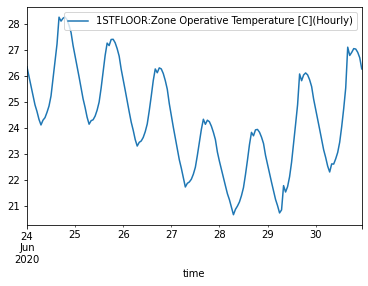

In [ ]:
V1919.plot(y ='1STFLOOR:Zone Operative Temperature [C](Hourly)', kind = 'line')

In [ ]:
Temp_Max_V1919 = V1919['1STFLOOR:Zone Operative Temperature [C](Hourly)'].loc[V1919.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]

In [ ]:
Temp_Max_V1919

time
2020-06-24 14:00:00    26.549552
2020-06-25 14:00:00    26.154038
2020-06-26 13:00:00    24.662087
2020-06-27 13:00:00    22.944307
2020-06-28 16:00:00    23.831252
2020-06-29 14:00:00    24.144258
2020-06-30 15:00:00    25.542275
Name: 1STFLOOR:Zone Operative Temperature [C](Hourly), dtype: float64

In [ ]:
url_V1946 = "/content/drive/My Drive/Buildings and Health/Buildings/V1946-_1_20200623.csv" 
V1946 = pd.read_csv(url_V1946, header=0, sep=",", encoding = "ISO-8859-1")

In [ ]:
V1946 = V1946.truncate(before=168, after=336)

In [ ]:
V1946['time'] = pd.date_range('2020-06-24', periods=168, freq='60min')

In [ ]:
V1946 = V1946.set_index('time')

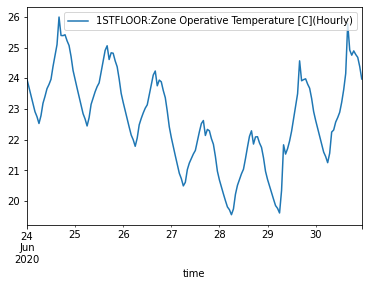

In [ ]:
V1946.plot(y ='1STFLOOR:Zone Operative Temperature [C](Hourly)', kind = 'line')

In [ ]:
Temp_Max_V1946 = V1946['1STFLOOR:Zone Operative Temperature [C](Hourly)'].loc[V1946.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]

In [ ]:
Temp_Max_V1946

time
2020-06-24 16:00:00    25.992846
2020-06-25 19:00:00    24.815299
2020-06-26 16:00:00    24.236479
2020-06-27 18:00:00    22.335888
2020-06-28 19:00:00    22.098413
2020-06-29 16:00:00    24.567718
2020-06-30 16:00:00    25.777671
Name: 1STFLOOR:Zone Operative Temperature [C](Hourly), dtype: float64

In [ ]:
url_V1961 = "/content/drive/My Drive/Buildings and Health/Buildings/V1961-_1_20200623.csv" 
V1961 = pd.read_csv(url_V1961, header=0, sep=",", encoding = "ISO-8859-1")
V1961

,Date/Time,1STFLOOR:Zone Mean Air Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),2NDFLOOR:Zone Mean Air Temperature [C](Hourly),2NDFLOOR:Zone Operative Temperature [C](Hourly)
0,01/01 01:00:00,24.582717,24.480151,27.553473,27.499332
1,01/01 02:00:00,24.351577,24.257641,27.106817,27.068950
2,01/01 03:00:00,24.102652,24.018697,26.671284,26.644890
3,01/01 04:00:00,23.851120,23.776338,26.261405,26.241746
4,01/01 05:00:00,23.597452,23.531453,25.866831,25.851537
...,...,...,...,...,...
331,01/14 20:00:00,25.265748,24.553231,27.926307,27.275096
332,01/14 21:00:00,25.002666,24.410431,27.646409,27.123562
333,01/14 22:00:00,24.920692,24.337429,27.484435,26.983151
334,01/14 23:00:00,24.462145,24.055389,26.941540,26.608564


In [ ]:
V1961 = V1961.truncate(before=168, after=336)

In [ ]:
V1961['time'] = pd.date_range('2020-06-24', periods=168, freq='60min')

In [ ]:
V1961 = V1961.set_index('time')

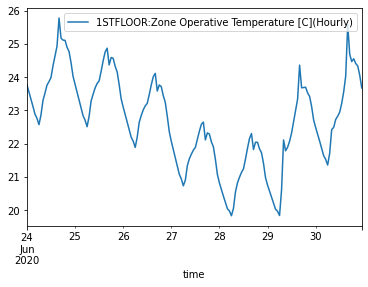

In [ ]:
V1961.plot(y ='1STFLOOR:Zone Operative Temperature [C](Hourly)', kind = 'line')

In [ ]:
Temp_Max_V1961 = V1961['1STFLOOR:Zone Operative Temperature [C](Hourly)'].loc[V1961.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]
Temp_Max_V1961

time
2020-06-24 16:00:00    25.778734
2020-06-25 18:00:00    24.590880
2020-06-26 16:00:00    24.113038
2020-06-27 16:00:00    22.647442
2020-06-28 19:00:00    22.039068
2020-06-29 16:00:00    24.361806
2020-06-30 16:00:00    25.578774
Name: 1STFLOOR:Zone Operative Temperature [C](Hourly), dtype: float64

In [ ]:
url_V1971 = "/content/drive/My Drive/Buildings and Health/Buildings/V1971-_1_20200623.csv" 
V1971 = pd.read_csv(url_V1971, header=0, sep=",", encoding = "ISO-8859-1")
V1971

,Date/Time,1STFLOOR:Zone Mean Air Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),2NDFLOOR:Zone Mean Air Temperature [C](Hourly),2NDFLOOR:Zone Operative Temperature [C](Hourly)
0,01/01 01:00:00,24.527003,24.421197,27.594539,27.534616
1,01/01 02:00:00,24.298142,24.201393,27.149760,27.108290
2,01/01 03:00:00,24.052219,23.965718,26.718052,26.688439
3,01/01 04:00:00,23.803777,23.726706,26.311203,26.288540
4,01/01 05:00:00,23.553548,23.485455,25.919432,25.901277
...,...,...,...,...,...
331,01/14 20:00:00,25.186079,24.474845,27.861732,27.212048
332,01/14 21:00:00,24.930730,24.338781,27.600010,27.077655
333,01/14 22:00:00,24.855097,24.271421,27.454209,26.952516
334,01/14 23:00:00,24.407602,23.996736,26.925897,26.591444


In [ ]:
V1971 = V1971.truncate(before=168, after=336)
V1971['time'] = pd.date_range('2020-06-24', periods=168, freq='60min')
V1971 = V1971.set_index('time')

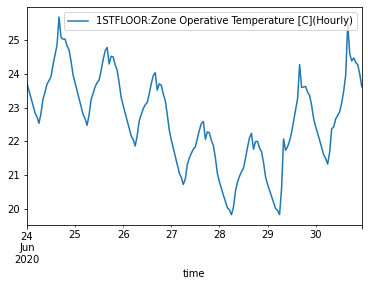

In [ ]:
V1971.plot(y ='1STFLOOR:Zone Operative Temperature [C](Hourly)', kind = 'line')

In [ ]:
Temp_Max_V1971 = V1971['1STFLOOR:Zone Operative Temperature [C](Hourly)'].loc[V1971.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]
Temp_Max_V1971

time
2020-06-24 16:00:00    25.686732
2020-06-25 18:00:00    24.523571
2020-06-26 16:00:00    24.037837
2020-06-27 18:00:00    22.282297
2020-06-28 19:00:00    21.998189
2020-06-29 16:00:00    24.279189
2020-06-30 16:00:00    25.491535
Name: 1STFLOOR:Zone Operative Temperature [C](Hourly), dtype: float64

In [ ]:
url_V1981 = "/content/drive/My Drive/Buildings and Health/Buildings/V1981-_1_20200623.csv" 
V1981 = pd.read_csv(url_V1981, header=0, sep=",", encoding = "ISO-8859-1")
V1981

,Date/Time,1STFLOOR:Zone Mean Air Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),2NDFLOOR:Zone Mean Air Temperature [C](Hourly),2NDFLOOR:Zone Operative Temperature [C](Hourly)
0,01/01 01:00:00,25.103920,25.032642,28.585119,28.554367
1,01/01 02:00:00,24.885736,24.816885,28.171251,28.145428
2,01/01 03:00:00,24.642058,24.579023,27.742195,27.723957
3,01/01 04:00:00,24.392641,24.335351,27.331243,27.317294
4,01/01 05:00:00,24.136503,24.085499,26.929237,26.918507
...,...,...,...,...,...
331,01/14 20:00:00,26.004538,25.306803,28.947681,28.321182
332,01/14 21:00:00,25.549066,25.010865,28.580159,28.078065
333,01/14 22:00:00,25.338445,24.836444,28.360506,27.886272
334,01/14 23:00:00,24.821620,24.504000,27.788034,27.489936


In [ ]:
V1981 = V1981.truncate(before=168, after=336)
V1981['time'] = pd.date_range('2020-06-24', periods=168, freq='60min')
V1981 = V1981.set_index('time')

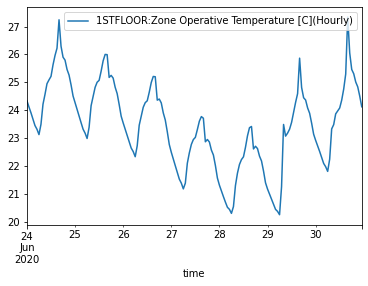

In [ ]:
V1981.plot(y ='1STFLOOR:Zone Operative Temperature [C](Hourly)', kind = 'line')

In [ ]:
Temp_Max_V1981 = V1981['1STFLOOR:Zone Operative Temperature [C](Hourly)'].loc[V1981.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]
Temp_Max_V1981

time
2020-06-24 16:00:00    27.242532
2020-06-25 15:00:00    26.000260
2020-06-26 15:00:00    25.209839
2020-06-27 15:00:00    23.770775
2020-06-28 16:00:00    23.416009
2020-06-29 16:00:00    25.866355
2020-06-30 16:00:00    27.340996
Name: 1STFLOOR:Zone Operative Temperature [C](Hourly), dtype: float64

In [ ]:
url_V1991 = "/content/drive/My Drive/Buildings and Health/Buildings/V1991-_1_20200623.csv" 
V1991 = pd.read_csv(url_V1991, header=0, sep=",", encoding = "ISO-8859-1")
V1991

,Date/Time,1STFLOOR:Zone Mean Air Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),2NDFLOOR:Zone Mean Air Temperature [C](Hourly),2NDFLOOR:Zone Operative Temperature [C](Hourly)
0,01/01 01:00:00,24.858358,24.775536,28.541409,28.504406
1,01/01 02:00:00,24.655249,24.575509,28.124252,28.093903
2,01/01 03:00:00,24.428003,24.354075,27.698304,27.675529
3,01/01 04:00:00,24.193110,24.125171,27.289242,27.271128
4,01/01 05:00:00,23.951468,23.889944,26.890251,26.875453
...,...,...,...,...,...
331,01/14 20:00:00,25.721324,25.013506,28.850676,28.215166
332,01/14 21:00:00,25.298332,24.736537,28.480643,27.969576
333,01/14 22:00:00,25.103535,24.576124,28.261690,27.777678
334,01/14 23:00:00,24.587893,24.251410,27.686625,27.380569


In [ ]:
V1991 = V1991.truncate(before=168, after=336)
V1991['time'] = pd.date_range('2020-06-24', periods=168, freq='60min')
V1991 = V1991.set_index('time')

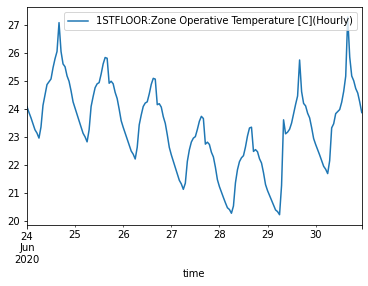

In [ ]:
V1991.plot(y ='1STFLOOR:Zone Operative Temperature [C](Hourly)', kind = 'line')

In [ ]:
Temp_Max_V1991 = V1991['1STFLOOR:Zone Operative Temperature [C](Hourly)'].loc[V1991.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]
Temp_Max_V1991

time
2020-06-24 16:00:00    27.091408
2020-06-25 15:00:00    25.845150
2020-06-26 15:00:00    25.101200
2020-06-27 15:00:00    23.743481
2020-06-28 16:00:00    23.355804
2020-06-29 16:00:00    25.757070
2020-06-30 16:00:00    27.290930
Name: 1STFLOOR:Zone Operative Temperature [C](Hourly), dtype: float64

In [ ]:
url_V1996 = "/content/drive/My Drive/Buildings and Health/Buildings/V1996-_1_20200623.csv" 
V1996 = pd.read_csv(url_V1996, header=0, sep=",", encoding = "ISO-8859-1")
V1996

,Date/Time,1STFLOOR:Zone Mean Air Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),2NDFLOOR:Zone Mean Air Temperature [C](Hourly),2NDFLOOR:Zone Operative Temperature [C](Hourly)
0,01/01 01:00:00,24.626659,24.544606,28.524268,28.486738
1,01/01 02:00:00,24.442748,24.362748,28.119563,28.087683
2,01/01 03:00:00,24.235343,24.160103,27.705105,27.680121
3,01/01 04:00:00,24.019542,23.949516,27.306146,27.285711
4,01/01 05:00:00,23.796144,23.731941,26.916787,26.899774
...,...,...,...,...,...
331,01/14 20:00:00,25.585592,24.853087,28.876074,28.216514
332,01/14 21:00:00,25.123456,24.542826,28.467325,27.938870
333,01/14 22:00:00,24.903420,24.362810,28.238894,27.735386
334,01/14 23:00:00,24.359087,24.021453,27.637697,27.322614


In [ ]:
V1996 = V1996.truncate(before=168, after=336)
V1996['time'] = pd.date_range('2020-06-24', periods=168, freq='60min')
V1996 = V1996.set_index('time')

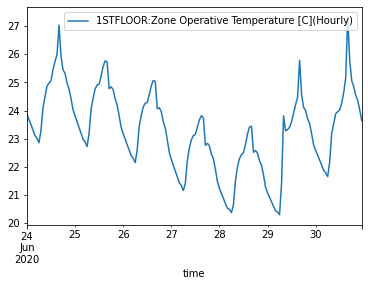

In [ ]:
V1996.plot(y ='1STFLOOR:Zone Operative Temperature [C](Hourly)', kind = 'line')

In [ ]:
Temp_Max_V1996 = V1996['1STFLOOR:Zone Operative Temperature [C](Hourly)'].loc[V1996.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]
Temp_Max_V1996

time
2020-06-24 16:00:00    27.044010
2020-06-25 15:00:00    25.770869
2020-06-26 15:00:00    25.070584
2020-06-27 15:00:00    23.817008
2020-06-28 16:00:00    23.442175
2020-06-29 16:00:00    25.790060
2020-06-30 16:00:00    27.330611
Name: 1STFLOOR:Zone Operative Temperature [C](Hourly), dtype: float64

In [ ]:
url_V2001 = "/content/drive/My Drive/Buildings and Health/Buildings/V2001-_1_20200623.csv" 
V2001 = pd.read_csv(url_V2001, header=0, sep=",", encoding = "ISO-8859-1")
V2001

,Date/Time,1STFLOOR:Zone Mean Air Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),2NDFLOOR:Zone Mean Air Temperature [C](Hourly),2NDFLOOR:Zone Operative Temperature [C](Hourly)
0,01/01 01:00:00,23.950134,23.876291,28.965969,28.938908
1,01/01 02:00:00,23.820665,23.745816,28.666190,28.637714
2,01/01 03:00:00,23.667211,23.594720,28.334551,28.310117
3,01/01 04:00:00,23.503628,23.434457,28.002868,27.981400
4,01/01 05:00:00,23.329988,23.265191,27.668715,27.650441
...,...,...,...,...,...
331,01/14 20:00:00,25.017905,24.282146,28.706094,28.050569
332,01/14 21:00:00,24.501757,23.910671,28.271956,27.745873
333,01/14 22:00:00,24.247690,23.694703,28.059577,27.559740
334,01/14 23:00:00,23.656728,23.325724,27.519592,27.205080


In [ ]:
V2001 = V2001.truncate(before=168, after=336)
V2001['time'] = pd.date_range('2020-06-24', periods=168, freq='60min')
V2001 = V2001.set_index('time')

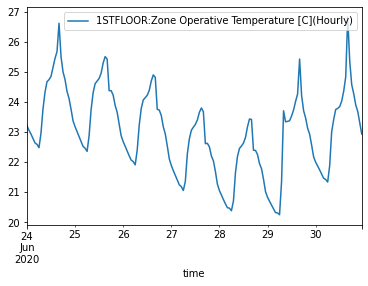

In [ ]:
V2001.plot(y ='1STFLOOR:Zone Operative Temperature [C](Hourly)', kind = 'line')

In [ ]:
Temp_Max_V2001 = V2001['1STFLOOR:Zone Operative Temperature [C](Hourly)'].loc[V2001.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]
Temp_Max_V2001

time
2020-06-24 16:00:00    26.626581
2020-06-25 15:00:00    25.517062
2020-06-26 15:00:00    24.908439
2020-06-27 15:00:00    23.808375
2020-06-28 15:00:00    23.443065
2020-06-29 16:00:00    25.437329
2020-06-30 16:00:00    26.833712
Name: 1STFLOOR:Zone Operative Temperature [C](Hourly), dtype: float64

In [ ]:
url_VAFTER = "/content/drive/My Drive/Buildings and Health/Buildings/VAFTER_1_20200623.csv" 
VAFTER = pd.read_csv(url_VAFTER, header=0, sep=",", encoding = "ISO-8859-1")

In [ ]:
VAFTER = VAFTER.truncate(before=168, after=336)
VAFTER['time'] = pd.date_range('2020-06-24', periods=168, freq='60min')
VAFTER = VAFTER.set_index('time')

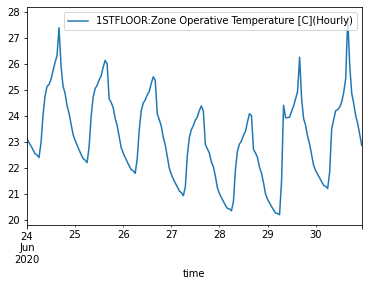

In [ ]:
VAFTER.plot(y ='1STFLOOR:Zone Operative Temperature [C](Hourly)', kind = 'line')

In [ ]:
Temp_Max_VAFTER = VAFTER['1STFLOOR:Zone Operative Temperature [C](Hourly)'].loc[VAFTER.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]
Temp_Max_VAFTER

time
2020-06-24 16:00:00    27.395839
2020-06-25 15:00:00    26.141744
2020-06-26 15:00:00    25.510563
2020-06-27 15:00:00    24.391112
2020-06-28 15:00:00    24.093685
2020-06-29 16:00:00    26.264402
2020-06-30 16:00:00    27.806362
Name: 1STFLOOR:Zone Operative Temperature [C](Hourly), dtype: float64

In [ ]:
# Concat all, index time (key)
new = pd.concat([V1919, V1946, V1961, V1971, V1981, V1991, V1996, V2001,VAFTER], axis= 1)

In [ ]:
new = pd.concat([V1919['1STFLOOR:Zone Operative Temperature [C](Hourly)'], V1946['1STFLOOR:Zone Operative Temperature [C](Hourly)']], axis= 1)
#new = new.rename(columns={"1STFLOOR:Zone Operative Temperature [C](Hourly)": "V1919", "1STFLOOR:Zone Operative Temperature [C](Hourly)": "V1946" })
new1 = pd.concat([V1961['1STFLOOR:Zone Operative Temperature [C](Hourly)'], V1971['1STFLOOR:Zone Operative Temperature [C](Hourly)']], axis= 1)
#new1 = new1.rename(columns={"1STFLOOR:Zone Operative Temperature [C](Hourly)": "V1961", "1STFLOOR:Zone Operative Temperature [C](Hourly)": "V1971" })
new2 = pd.concat([V1981['1STFLOOR:Zone Operative Temperature [C](Hourly)'], V1991['1STFLOOR:Zone Operative Temperature [C](Hourly)']], axis= 1)
#new2 = new2.rename(columns={"1STFLOOR:Zone Operative Temperature [C](Hourly)": "V1981", "1STFLOOR:Zone Operative Temperature [C](Hourly)": "V1991" })
new3 = pd.concat([V1996['1STFLOOR:Zone Operative Temperature [C](Hourly)'], V2001['1STFLOOR:Zone Operative Temperature [C](Hourly)']], axis= 1)
#new3 = new3.rename(columns={"1STFLOOR:Zone Operative Temperature [C](Hourly)": "V1996", "1STFLOOR:Zone Operative Temperature [C](Hourly)": "V2001" })
new4 = VAFTER['1STFLOOR:Zone Operative Temperature [C](Hourly)']

In [ ]:
result = pd.concat([new, new1], axis=1, sort=False)
result1 = pd.concat([new2, new3], axis=1, sort=False)
result2 = pd.concat([result1, new4], axis=1, sort=False)
result3 = pd.concat([result, result2], axis=1, sort=False)

In [ ]:
result3

,1STFLOOR:Zone Operative Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly),1STFLOOR:Zone Operative Temperature [C](Hourly)
time,,,,,,,,,
2020-06-24 00:00:00,26.357790,23.972653,23.769723,23.718478,24.336576,24.088477,23.867484,23.217320,23.145068
2020-06-24 01:00:00,25.991638,23.706444,23.552749,23.504609,24.114760,23.883351,23.677956,23.068179,22.982535
2020-06-24 02:00:00,25.626945,23.449931,23.343038,23.297620,23.907547,23.692025,23.503877,22.942640,22.858000
2020-06-24 03:00:00,25.258164,23.182328,23.117584,23.075112,23.682295,23.481635,23.311235,22.798619,22.712138
2020-06-24 04:00:00,24.894440,22.913901,22.886630,22.847271,23.449756,23.263647,23.111197,22.647198,22.560067
...,...,...,...,...,...,...,...,...,...
2020-06-30 19:00:00,27.059668,24.891125,24.553231,24.474845,25.306803,25.013506,24.853087,24.282146,24.480594
2020-06-30 20:00:00,27.042807,24.774208,24.410431,24.338781,25.010865,24.736537,24.542826,23.910671,24.009276
2020-06-30 21:00:00,26.915353,24.680482,24.337429,24.271421,24.836444,24.576124,24.362810,23.694703,23.707254


In [ ]:
result3.columns = ['V1919', 'V1946','V1961', 'V1971', 'V1981','V1991', 'V1996', 'V2001','VAFTER']

NameError: ignored

In [ ]:
result3

NameError: ignored

In [ ]:
#Dictionary
data = {
        'Censos_ID': ['N_EDIFICIOS_CONSTR_ANTES_1919',
                  'N_EDIFICIOS_CONSTR_1919A1945',
                  'N_EDIFICIOS_CONSTR_1946A1960',
                  'N_EDIFICIOS_CONSTR_1961A1970', 
                  'N_EDIFICIOS_CONSTR_1971A1980',
                  'N_EDIFICIOS_CONSTR_1981A1990',
                  'N_EDIFICIOS_CONSTR_1991A1995', 
                  'N_EDIFICIOS_CONSTR_1996A2000', 
                  'N_EDIFICIOS_CONSTR_2001A2005',
                  'N_EDIFICIOS_CONSTR_2006A2011'],
        'sim':  ['V1919', 'V1919', 'V1946','V1961', 'V1971', 'V1981','V1991', 'V1996', 'V2001','VAFTER']
        }

dictprofiles = pd.DataFrame (data)

In [ ]:
dictprofiles = dict(zip(dictprofiles.Censos_ID, dictprofiles.sim))

In [ ]:
dictprofiles

{'N_EDIFICIOS_CONSTR_1919A1945': 'V1919',
 'N_EDIFICIOS_CONSTR_1946A1960': 'V1946',
 'N_EDIFICIOS_CONSTR_1961A1970': 'V1961',
 'N_EDIFICIOS_CONSTR_1971A1980': 'V1971',
 'N_EDIFICIOS_CONSTR_1981A1990': 'V1981',
 'N_EDIFICIOS_CONSTR_1991A1995': 'V1991',
 'N_EDIFICIOS_CONSTR_1996A2000': 'V1996',
 'N_EDIFICIOS_CONSTR_2001A2005': 'V2001',
 'N_EDIFICIOS_CONSTR_2006A2011': 'VAFTER',
 'N_EDIFICIOS_CONSTR_ANTES_1919': 'V1919'}

In [ ]:
censosbgri

,ANO,GEO_COD,GEO_COD_DSG,NIVEL,NIVEL_DSG,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_1946A1960,N_EDIFICIOS_CONSTR_1961A1970,N_EDIFICIOS_CONSTR_1971A1980,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_1991A1995,N_EDIFICIOS_CONSTR_1996A2000,N_EDIFICIOS_CONSTR_2001A2005,N_EDIFICIOS_CONSTR_2006A2011,N_INDIVIDUOS_RESIDENT_0A4,N_INDIVIDUOS_RESIDENT_5A9,N_INDIVIDUOS_RESIDENT_10A13,N_INDIVIDUOS_RESIDENT_14A19,N_INDIVIDUOS_RESIDENT_15A19,N_INDIVIDUOS_RESIDENT_20A24,N_INDIVIDUOS_RESIDENT_20A64,N_INDIVIDUOS_RESIDENT_25A64,N_INDIVIDUOS_RESIDENT_65,all buildings,all pop,Minimum,idxmax,idxmin
83,2011,17060100101,,8,Subsecção,0,1,1,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,5,1,0,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_ANTES_1919
84,2011,17060100102,,8,Subsecção,7,1,1,3,1,1,0,0,0,1,0,1,0,1,1,1,5,4,6,15,19,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1991A1995
85,2011,17060100103,,8,Subsecção,0,0,0,0,0,3,1,1,0,0,0,0,0,2,2,1,6,5,0,5,16,0,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_ANTES_1919
86,2011,17060100104,,8,Subsecção,1,3,0,2,0,1,0,2,1,0,0,0,0,0,0,0,1,1,3,10,5,0,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_1946A1960
87,2011,17060100105,,8,Subsecção,1,1,1,0,1,1,1,0,2,0,0,0,0,2,2,1,8,7,3,8,23,0,N_EDIFICIOS_CONSTR_2001A2005,N_EDIFICIOS_CONSTR_1961A1970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1495,2011,17063500121,,8,Subsecção,0,0,0,0,2,3,1,0,0,0,0,0,0,0,0,1,4,3,2,6,10,0,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_ANTES_1919
1496,2011,17063500122,,8,Subsecção,0,1,1,1,1,7,0,0,0,0,0,0,0,0,0,0,1,1,1,11,3,0,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_ANTES_1919
1497,2011,17063500123,,8,Subsecção,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_ANTES_1919
1498,2011,17063500124,,8,Subsecção,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_ANTES_1919


In [ ]:
censosbgri['thermal profile'] = censosbgri['idxmax'].map(dictprofiles)
censosbgri['thermal profile']

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



83      V1919
84      V1919
85      V1981
86      V1919
87      V2001
        ...  
1495    V1981
1496    V1981
1497    V1919
1498    V1919
1499    V1971
Name: thermal profile, Length: 1417, dtype: object

In [ ]:
maxtemperatureday = result3.loc[result3.groupby(pd.Grouper(freq='D')).idxmax().iloc[:, 0]]
forescasts = pd.DataFrame(maxtemperatureday)
forescasts

,V1919,V1946,V1961,V1971,V1981,V1991,V1996,V2001,VAFTER
time,,,,,,,,,
2020-06-24 19:00:00,28.276379,25.416536,25.107783,25.032542,25.795057,25.515128,25.325434,24.750260,24.880649
2020-06-25 19:00:00,27.418752,24.815299,24.567164,24.505100,25.150637,24.907425,24.739803,24.236761,24.329285
2020-06-26 18:00:00,26.317677,23.940899,23.764815,23.708512,24.399997,24.194703,24.102006,23.738056,23.864271
2020-06-27 00:00:00,24.477351,22.074261,22.069394,22.044002,22.491330,22.369371,22.263175,21.899009,21.766161
2020-06-28 19:00:00,23.944010,22.098413,22.039068,21.998189,22.622684,22.479096,22.481403,22.259443,22.406090
2020-06-29 19:00:00,26.122475,23.982647,23.696281,23.626988,24.364740,24.115549,23.997528,23.477669,23.643155
2020-06-30 16:00:00,27.115016,25.777671,25.578774,25.491535,27.340996,27.290930,27.330611,26.833712,27.806362


In [ ]:
day1 = forescasts.loc[forescasts.index == '2020-06-24 19:00:00']

In [ ]:
day1

,V1919,V1946,V1961,V1971,V1981,V1991,V1996,V2001,VAFTER
time,,,,,,,,,
2020-06-24 19:00:00,28.276379,25.416536,25.107783,25.032542,25.795057,25.515128,25.325434,24.75026,24.880649


In [ ]:
day1 = day1.T

In [ ]:
day1 = day1.reset_index()

In [ ]:
day1.columns = ['a', 'b']

In [ ]:
dic_day1 = dict(zip(day1.a, day1.b))

In [ ]:
dic_day1 

{'V1919': 28.276378817347407,
 'V1946': 25.416535640392443,
 'V1961': 25.107783438002414,
 'V1971': 25.03254230335579,
 'V1981': 25.795056553515487,
 'V1991': 25.51512827448256,
 'V1996': 25.32543390693945,
 'V2001': 24.75026029969854,
 'VAFTER': 24.88064891827334}

In [ ]:
censosbgri['day 1']= censosbgri['thermal profile'].map(dic_day1) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
day2 = forescasts.loc[forescasts.index == '2020-06-25 19:00:00']
day2 = day2.T
day2 = day2.reset_index()
day2.columns = ['a', 'b']
dic_day2 = dict(zip(day2.a, day2.b))
censosbgri['day 2']= censosbgri['thermal profile'].map(dic_day2) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
day3 = forescasts.loc[forescasts.index == '2020-06-26 18:00:00']
day3 = day3.T
day3 = day3.reset_index()
day3.columns = ['a', 'b']
dic_day3 = dict(zip(day3.a, day3.b))
censosbgri['day 3']= censosbgri['thermal profile'].map(dic_day3) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
day4 = forescasts.loc[forescasts.index == '2020-06-27 00:00:00']
day4 = day4.T
day4 = day4.reset_index()
day4.columns = ['a', 'b']
dic_day4 = dict(zip(day4.a, day4.b))
censosbgri['day 4']= censosbgri['thermal profile'].map(dic_day4) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
day5 = forescasts.loc[forescasts.index == '2020-06-28 19:00:00']
day5 = day5.T
day5 = day5.reset_index()
day5.columns = ['a', 'b']
dic_day5 = dict(zip(day5.a, day5.b))
censosbgri['day 5']= censosbgri['thermal profile'].map(dic_day5) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
day5 = forescasts.loc[forescasts.index == '2020-06-29 19:00:00']
day5 = day5.T
day5 = day5.reset_index()
day5.columns = ['a', 'b']
dic_day5 = dict(zip(day5.a, day5.b))
censosbgri['day 5']= censosbgri['thermal profile'].map(dic_day5) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
day6 = forescasts.loc[forescasts.index == '2020-06-30 16:00:00']
day6 = day6.T
day6 = day6.reset_index()
day6.columns = ['a', 'b']
dic_day6 = dict(zip(day6.a, day6.b))
censosbgri['day 6']= censosbgri['thermal profile'].map(dic_day6) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Discomfort hours per profile

In [ ]:
V1919['new'] = [1 if x > 26 else 0 for x in (V1919['1STFLOOR:Zone Operative Temperature [C](Hourly)'])] 
Discomfort_hours_V1919 = V1919['new'].resample('D').sum()
V1946['new'] = [1 if x > 26 else 0 for x in (V1946['1STFLOOR:Zone Operative Temperature [C](Hourly)'])] 
Discomfort_hours_V1946 = V1946['new'].resample('D').sum()
V1961['new'] = [1 if x > 26 else 0 for x in (V1961['1STFLOOR:Zone Operative Temperature [C](Hourly)'])] 
Discomfort_hours_V1961 = V1961['new'].resample('D').sum()
V1971['new'] = [1 if x > 26 else 0 for x in (V1971['1STFLOOR:Zone Operative Temperature [C](Hourly)'])] 
Discomfort_hours_V1971 = V1971['new'].resample('D').sum()
V1981['new'] = [1 if x > 26 else 0 for x in (V1981['1STFLOOR:Zone Operative Temperature [C](Hourly)'])] 
Discomfort_hours_V1981 = V1981['new'].resample('D').sum()
V1991['new'] = [1 if x > 26 else 0 for x in (V1991['1STFLOOR:Zone Operative Temperature [C](Hourly)'])] 
Discomfort_hours_V1991 = V1991['new'].resample('D').sum()
V1996['new'] = [1 if x > 26 else 0 for x in (V1996['1STFLOOR:Zone Operative Temperature [C](Hourly)'])] 
Discomfort_hours_V1996 = V1996['new'].resample('D').sum()
V2001['new'] = [1 if x > 26 else 0 for x in (V2001['1STFLOOR:Zone Operative Temperature [C](Hourly)'])] 
Discomfort_hours_V2001 = V2001['new'].resample('D').sum()
VAFTER['new'] = [1 if x > 26 else 0 for x in (VAFTER['1STFLOOR:Zone Operative Temperature [C](Hourly)'])] 
Discomfort_hours_VAFTER = VAFTER['new'].resample('D').sum()

In [ ]:
Discomfort_hours1 = pd.concat([Discomfort_hours_V1919, Discomfort_hours_V1946], axis=1, sort=False)
Discomfort_hours2 = pd.concat([Discomfort_hours_V1961, Discomfort_hours_V1971], axis=1, sort=False)
Discomfort_hours3 = pd.concat([Discomfort_hours_V1981, Discomfort_hours_V1991], axis=1, sort=False)
Discomfort_hours4 = pd.concat([Discomfort_hours_V1996, Discomfort_hours_V2001], axis=1, sort=False)
Discomfort_hours5 = pd.concat([Discomfort_hours1, Discomfort_hours2], axis=1, sort=False)
Discomfort_hours6 = pd.concat([Discomfort_hours5, Discomfort_hours3], axis=1, sort=False)
Discomfort_hours7 = pd.concat([Discomfort_hours6, Discomfort_hours4], axis=1, sort=False)
Discomfort_hours8 = pd.concat([Discomfort_hours7, Discomfort_hours_VAFTER], axis=1, sort=False)
Discomfort_hours8.columns = ['V1919', 'V1946','V1961', 'V1971', 'V1981','V1991', 'V1996', 'V2001','VAFTER']

In [ ]:
Discomfort_hours8

,V1919,V1946,V1961,V1971,V1981,V1991,V1996,V2001,VAFTER
time,,,,,,,,,
2020-06-24,11,0,0,0,3,3,1,1,3
2020-06-25,12,0,0,0,1,0,0,0,1
2020-06-26,5,0,0,0,0,0,0,0,0
2020-06-27,0,0,0,0,0,0,0,0,0
2020-06-28,0,0,0,0,0,0,0,0,0
2020-06-29,4,0,0,0,0,0,0,0,1
2020-06-30,8,0,0,0,2,1,1,1,1


In [ ]:
D_day1 = Discomfort_hours8.loc[Discomfort_hours8.index == '2020-06-24']
D_day1 = D_day1.T
D_day1 = D_day1.reset_index()
D_day1.columns = ['a', 'b']
D_dic_day1 = dict(zip(D_day1.a, D_day1.b))
censosbgri['Discomfort day 1']= censosbgri['thermal profile'].map(D_dic_day1) 

D_day2 = Discomfort_hours8.loc[Discomfort_hours8.index == '2020-06-25']
D_day2 = D_day2.T
D_day2 = D_day2.reset_index()
D_day2.columns = ['a', 'b']
D_dic_day2 = dict(zip(D_day2.a, D_day2.b))
censosbgri['Discomfort day 2']= censosbgri['thermal profile'].map(D_dic_day2) 

D_day3 = Discomfort_hours8.loc[Discomfort_hours8.index == '2020-06-26']
D_day3 = D_day3.T
D_day3 = D_day3.reset_index()
D_day3.columns = ['a', 'b']
D_dic_day3 = dict(zip(D_day3.a, D_day3.b))
censosbgri['Discomfort day 3']= censosbgri['thermal profile'].map(D_dic_day3) 

D_day4 = Discomfort_hours8.loc[Discomfort_hours8.index == '2020-06-27']
D_day4 = D_day4.T
D_day4 = D_day4.reset_index()
D_day4.columns = ['a', 'b']
D_dic_day4 = dict(zip(D_day4.a, D_day4.b))
censosbgri['Discomfort day 4']= censosbgri['thermal profile'].map(D_dic_day4) 

D_day5 = Discomfort_hours8.loc[Discomfort_hours8.index == '2020-06-28']
D_day5 = D_day5.T
D_day5 = D_day5.reset_index()
D_day5.columns = ['a', 'b']
D_dic_day5 = dict(zip(D_day5.a, D_day5.b))
censosbgri['Discomfort day 5']= censosbgri['thermal profile'].map(D_dic_day5)

D_day6 = Discomfort_hours8.loc[Discomfort_hours8.index == '2020-06-29']
D_day6 = D_day6.T
D_day6 = D_day6.reset_index()
D_day6.columns = ['a', 'b']
D_dic_day6 = dict(zip(D_day6.a, D_day6.b))
censosbgri['Discomfort day 6']= censosbgri['thermal profile'].map(D_dic_day6) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

## Data merged with Map

In [ ]:
map_df = map_df.merge(censosbgri, left_on='BGRI11', right_on='GEO_COD', how='outer')

In [ ]:
map_df

,DTMN11,FR11,SEC11,SS11,BGRI11,LUG11,LUG11DESIG,geometry,Freguesias,IV,ANO,GEO_COD,GEO_COD_DSG,NIVEL,NIVEL_DSG,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1919A1945,N_EDIFICIOS_CONSTR_1946A1960,N_EDIFICIOS_CONSTR_1961A1970,N_EDIFICIOS_CONSTR_1971A1980,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_1991A1995,N_EDIFICIOS_CONSTR_1996A2000,N_EDIFICIOS_CONSTR_2001A2005,N_EDIFICIOS_CONSTR_2006A2011,N_INDIVIDUOS_RESIDENT_0A4,N_INDIVIDUOS_RESIDENT_5A9,N_INDIVIDUOS_RESIDENT_10A13,N_INDIVIDUOS_RESIDENT_14A19,N_INDIVIDUOS_RESIDENT_15A19,N_INDIVIDUOS_RESIDENT_20A24,N_INDIVIDUOS_RESIDENT_20A64,N_INDIVIDUOS_RESIDENT_25A64,N_INDIVIDUOS_RESIDENT_65,all buildings,all pop,Minimum,idxmax,idxmin,thermal profile,day 1,day 2,day 3,day 4,day 5,day 6,Discomfort day 1,Discomfort day 2,Discomfort day 3,Discomfort day 4,Discomfort day 5,Discomfort day 6
0,1706,34,002,38,17063400238,999999,Residual,"POLYGON ((-7.81889 41.75777, -7.81888 41.75774...",0,9,2011,17063400238,,8,Subsecção,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1919A1945,V1919,28.276379,27.418752,26.317677,24.477351,26.122475,27.115016,11,12,5,0,0,4
1,1706,25,001,15,17062500115,014045,Ladrugães,"POLYGON ((-7.91912 41.72123, -7.91909 41.72118...",1,14,2011,17062500115,,8,Subsecção,10,2,0,9,5,0,0,0,1,0,0,0,0,0,0,1,4,3,8,27,16,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_1946A1960,V1919,28.276379,27.418752,26.317677,24.477351,26.122475,27.115016,11,12,5,0,0,4
2,1706,26,001,42,17062600142,999999,Residual,"POLYGON ((-7.93366 41.68217, -7.93345 41.68212...",2,10,2011,17062600142,,8,Subsecção,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_ANTES_1919,V1919,28.276379,27.418752,26.317677,24.477351,26.122475,27.115016,11,12,5,0,0,4
3,1706,12,001,31,17061200131,999999,Residual,"POLYGON ((-7.70527 41.84761, -7.70527 41.84712...",3,10,2011,17061200131,,8,Subsecção,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_ANTES_1919,V1919,28.276379,27.418752,26.317677,24.477351,26.122475,27.115016,11,12,5,0,0,4
4,1706,08,001,08,17060800108,013976,Donões,"POLYGON ((-7.81780 41.83350, -7.81773 41.83344...",4,9,2011,17060800108,,8,Subsecção,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,2,5,2,0,N_EDIFICIOS_CONSTR_1971A1980,N_EDIFICIOS_CONSTR_ANTES_1919,V1971,25.032542,24.505100,23.708512,22.044002,23.626988,25.491535,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1412,1706,15,001,44,17061500144,999999,Residual,"POLYGON ((-7.77479 41.84798, -7.77484 41.84792...",1412,9,2011,17061500144,,8,Subsecção,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N_EDIFICIOS_CONSTR_ANTES_1919,N_EDIFICIOS_CONSTR_ANTES_1919,V1919,28.276379,27.418752,26.317677,24.477351,26.122475,27.115016,11,12,5,0,0,4
1413,1706,28,002,03,17062800203,014068,Vilar de Perdizes,"POLYGON ((-7.63507 41.85568, -7.63508 41.85529...",1413,12,2011,17062800203,,8,Subsecção,0,0,0,0,0,1,0,4,1,1,1,0,0,1,0,0,7,7,0,7,16,0,N_EDIFICIOS_CONSTR_1996A2000,N_EDIFICIOS_CONSTR_ANTES_1919,V1996,25.325434,24.739803,24.102006,22.263175,23.997528,27.330611,1,0,0,0,0,0
1414,1706,28,002,02,17062800202,014068,Vilar de Perdizes,"POLYGON ((-7.63459 41.85612, -7.63459 41.85610...",1414,12,2011,17062800202,,8,Subsecção,0,0,1,1,1,3,1,1,0,0,0,0,0,1,1,1,8,7,2,8,20,0,N_EDIFICIOS_CONSTR_1981A1990,N_EDIFICIOS_CONSTR_ANTES_1919,V1981,25.795057,25.150637,24.399997,22.491330,24.364740,27.340996,3,1,0,0,0,0
1415,1706,28,001,11,17062800111,014068,Vilar de Perdizes,"POLYGON ((-7.62965 41.85642, -7.62956 41.85627...",1415,12,2011,17062800111,,8,Subsecção,1,2,0,0,4,2,1,0,2,6,0,0,1,2,2,0,6,6,16,18,33,0,N_EDIFICIOS_CONSTR_2006A2011,N_EDIFICIOS_CONSTR_1946A1960,VAFTER,24.880649,24.329285,23.864271,21.766161,23.643155,27.806362,3,1,0,0,0,1


In [ ]:
from google.colab import files
map_df.to_csv('map_df3.csv')
files.download("map_df3.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## By indoor temperature (day 1)

In [ ]:
from urllib.request import urlopen
import json
import plotly.express as px


fig1 = px.choropleth_mapbox(map_df, geojson=map_df, locations='Freguesias', color='day 1',
                           color_continuous_scale=["blue", "orange", "red"],
                           range_color=(20, 30),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 41.785061, "lon": -7.781880},
                           opacity=0.5)
fig1.show()

## By Population

In [ ]:
from urllib.request import urlopen
import json
import plotly.express as px


fig2 = px.choropleth_mapbox(map_df, geojson=map_df, locations='Freguesias', color='all pop',
                           color_continuous_scale=["blue", "orange", "red"],
                           range_color=(20, 30),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 41.785061, "lon": -7.781880},
                           opacity=0.5)
fig2.show()

## By buildings

In [ ]:
from urllib.request import urlopen
import json
import plotly.express as px


fig3 = px.choropleth_mapbox(map_df, geojson=map_df, locations='Freguesias', color='all buildings',
                           color_continuous_scale="Viridis",
                           range_color=(0, 100),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 41.785061, "lon": -7.781880},
                           opacity=0.5)
fig3.show()

## Interactive plot

In [ ]:
#https://plotly.com/python/mapbox-county-choropleth/
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/d-vf/dash/master/data/map_df.json') as response:
    counties = json.load(response)

In [ ]:
counties.keys()

dict_keys(['type', 'crs', 'features'])

In [ ]:
print(map_df["BGRI11"][2])
print(counties["features"][2]["properties"]["BGRI11"])

17062600142
17062600142


In [ ]:
#need to have a feature-id associated with each feature, so you can associate the GeoJSON-formatted geometry with the z attribute (https://plot.ly/python/mapbox-county-choropleth/ 200). 
#If you did not have an id in the first place, you can add it, since this j_file is basically a big dict (there’s probably a better way of doing this though):
i=0
for feature in counties["features"]:
  feature ['id'] = str(i).zfill(0)
  i += 1

#add data indexed by the same ‘id’ as the j_file. the locations attribute of the Choroplethmapbox chart should be a list (or a column of a pandas DataFrame) with the same values as the the ‘id’ key values in the j_file. The z attribute should have the values in the same order.

In [ ]:
counties['features'][0].keys()

dict_keys(['type', 'properties', 'geometry', 'id'])

In [ ]:
def update_output(num_clicks, val_selected):
    if val_selected is None:
        raise PreventUpdate
    else:
        df = px.data.map_df().query("IV=={}".format(val_selected))
        # print(df[:3])


fig3 = px.choropleth_mapbox(map_df, geojson=counties, locations='Freguesias', color='all buildings',
                           color_continuous_scale="Viridis",
                           range_color=(0, 100),
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 41.785061, "lon": -7.781880},
                           opacity=0.5)

fig3.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig3.update_layout(title=dict(font=dict(size=28),x=0.5,xanchor='center'),
                  margin=dict(l=60, r=60, t=50, b=50))

fig3.show()

In [ ]:
map_df.dtypes

DTMN11                             object
FR11                               object
SEC11                              object
SS11                               object
BGRI11                             object
LUG11                              object
LUG11DESIG                         object
geometry                         geometry
Freguesias                          int64
IV                                  int64
ANO                                 int64
GEO_COD                            object
GEO_COD_DSG                        object
NIVEL                               int64
NIVEL_DSG                          object
N_EDIFICIOS_CONSTR_ANTES_1919       int64
N_EDIFICIOS_CONSTR_1919A1945        int64
N_EDIFICIOS_CONSTR_1946A1960        int64
N_EDIFICIOS_CONSTR_1961A1970        int64
N_EDIFICIOS_CONSTR_1971A1980        int64
N_EDIFICIOS_CONSTR_1981A1990        int64
N_EDIFICIOS_CONSTR_1991A1995        int64
N_EDIFICIOS_CONSTR_1996A2000        int64
N_EDIFICIOS_CONSTR_2001A2005      

In [ ]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import plotly.express as px

# Data
cols_dd = ["day 1", "day 2", "day 3"]
# we need to add this to select which trace 
# is going to be visible
visible = np.array(cols_dd)


fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=map_df.Freguesias, z=map_df.IV,
                                    colorscale="Viridis", zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=9, mapbox_center = {"lat": 41.785061, "lon": -7.781880})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()